In [1]:
from pyspark import SparkConf, SparkContext

from pyspark.mllib.feature import Word2Vec

from sklearn.manifold import TSNE

from numpy.random import rand
from sklearn.preprocessing import MinMaxScaler
import numpy as np
import matplotlib.pyplot as plt

#sc = SparkContext('local[5]') #spark://172.26.5.43:7077

conf = (SparkConf()
         .setMaster("local[5]")
         .setAppName("My app")
         .set("spark.executor.memory", "3g")
         .set("spark.driver.memory", "3g")
         .set("spark.memory.fraction","0.5")
         .set("spark.memory.storageFraction","0.1")
       )

sc = SparkContext(conf = conf)

#analytics/pdml-html-tokenized
#/analytics/packets-html-langs
data = sc.textFile('hdfs://172.26.5.36/analytics/pdml-html-tokenized-eng-nonjs/',100)\
        .map(lambda doc:  doc.split(" "))
        
             
docs = sc.parallelize(data.take(100))
           
word2vec = Word2Vec().setVectorSize(1000).setSeed(42)
model = word2vec.fit(docs)
print("model is created...")
# Save and load model
#model.save(sc, "myModelPath")
#val sameModel = Word2VecModel.load(sc, "myModelPath")



model is created...


In [3]:
from pyspark import SparkConf, SparkContext
from pyspark.mllib.feature import Word2Vec

from sklearn.manifold import TSNE
from sklearn.preprocessing import MinMaxScaler

#n_samples = 100
X_list = []
word_list = []
model_vectors =  model.getVectors() #word to vec


for word, vector in model_vectors.items():
    #print(word, " -> ", vector)
    word_list.append(word)
    X_list.append(vector) 

X_raw = np.array(X_list) #X_list[:n_samples]
print("transforming data to two dimensions...")


modelTSNE = TSNE(perplexity=30, n_components=3, init='pca', n_iter=5000)
np.set_printoptions(suppress=True)
X_3d = modelTSNE.fit_transform(X_raw) 

X_scaled = MinMaxScaler().fit_transform(X_3d)
wordmap = {}

#print("scaled  2d word to syns map...\n",syns_2d_scaled)
print("formatting data...")
for i in range(0, len(X_scaled)):
    x = X_scaled[i][0]
    y = X_scaled[i][1]
    z = X_scaled[i][2]
    key = word_list[i]
    wordmap[key] = {"x": x, "y": y, "z" : z}
    vec = [x,y,z]
    print(vec)
    
print("formatting complete...")

transforming data to two dimensions...
formatting data...
[0.67621040019046275, 0.79774722074325966, 0.92411657289370441]
[0.77091995348480347, 0.74355342090504195, 0.67098927260931507]
[0.62584910842976471, 0.63760300016412996, 0.022087136559186704]
[0.67705731108935663, 0.53214258406097426, 0.74496363749115613]
[0.10192681723224056, 0.5143180023268169, 0.33963814300863143]
[0.30927401064325799, 0.47064664281889995, 0.38544898421847029]
[0.17042768393135088, 0.82868092894647893, 0.44485414594328343]
[0.56074390403990415, 0.37925175772660957, 0.17325017576335933]
[0.56083990606789758, 0.48339366096294589, 0.6720833984177037]
[0.46501104882962957, 0.56994364391673435, 0.46715065603689204]
[0.26216281976087752, 0.63401579311543299, 0.26640804969354287]
[0.21191752548511139, 0.57216527716101451, 0.78440441702592301]
[0.47442007128786923, 0.50740581738213542, 0.45864519413482951]
[0.49650712155057852, 0.70611566715522589, 0.76167910421741181]
[0.44278562371453645, 0.28174716602647765, 0.51

In [5]:
print("formatting data...")
for i in range(0, len(X_scaled)):
    x = X_3d[i][0]
    y = X_3d[i][1]
    z = X_3d[i][2]
  
    vec = [x,y,z]
    print(vec, ",")

formatting data...
[4.2033227646626532, 5.3397445407345812, 7.3335616501302612] ,
[6.2534945883310691, 4.1476283799510547, 3.2101047080754301] ,
[3.1131550067127591, 1.8170073645561486, -7.3605449792713342] ,
[4.2216557923422764, -0.50283488187862047, 4.4151509755599019] ,
[-8.2281583227541475, -0.89492718778685021, -2.1876224990436484] ,
[-3.7397264923677764, -1.8555782878793223, -1.4413615031105633] ,
[-6.745324311628325, 6.0202019652389636, -0.47364831597956814] ,
[1.7038266869027969, -3.8660171177219635, -4.8980911756387089] ,
[1.7059048368460803, -1.5751785673083025, 3.2279280746384704] ,
[-0.36849648984648031, 0.32868559617094123, -0.11043700204467218] ,
[-4.7595395182654734, 1.7380985685759007, -3.3805445438336448] ,
[-5.8471962858564046, 0.37755548353345519, 5.0576433341082323] ,
[-0.16481996449960176, -1.0469764517889741, -0.24899142065554211] ,
[0.31329704209027642, 3.3240996478484495, 4.6874468015519133] ,
[-0.84960888828009218, -6.0108528713196634, 0.70816160571808839] ,
[0

In [89]:
from pyspark.mllib.clustering import KMeans, KMeansModel
from numpy import array
from math import sqrt

# Build the model (cluster the data)
N = 300
dataVectrors = sc.parallelize(X_scaled)

kMeansModel = KMeans.train(dataVectrors, N, maxIterations=1000,\
                           runs=100, initializationMode="random")

vectors = dataVectrors.collect()
clusters = {}
for v in vectors:
    cluster_id = kMeansModel.predict(v)
    clusters.setdefault(cluster_id, []).append(v)
    
# Evaluate clustering by computing Within Set Sum of Squared Errors
def error(point):
    center = kMeansModel.centers[kMeansModel.predict(point)]
    return sqrt(sum([x**2 for x in (point - center)]))

WSSSE = dataVectrors.map(lambda point: error(point)).reduce(lambda x, y: x + y)
print("Within Set Sum of Squared Error = ", str(WSSSE))

# Save and load model
#clusters.save(sc, "myModelPath")
#sameModel = KMeansModel.load(sc, "myModelPath")

Within Set Sum of Squared Error =  157.91737455298974


In [90]:
%matplotlib inline

import colorsys
HSV_tuples = [(x*1.0/N, 0.5, 0.5) for x in range(N)]
#print(HSV_tuples)

RGB_tuples = list(map(lambda x: colorsys.hsv_to_rgb(*x), HSV_tuples))

print("colors are ready for", N, "clusters")
#print(HSV_tuples)


colors are ready for 300 clusters


In [133]:
%matplotlib inline

import matplotlib
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d import proj3d

labels = []
x = []
y = []
z = []

for word, vector in wordmap.items():
    #print(word, "->" ,vector)
    labels.append(word)
    x.append(vector.get('x'))
    y.append(vector.get('y'))
    z.append(vector.get('z'))
    

fig = plt.figure(figsize=(250, 250))
ax = fig.add_subplot(111, projection='3d')

for clusterId, clusterVectors in clusters.items():
    clusterColor =  RGB_tuples[clusterId]
    #print("drow cluster #",clusterId, "with color", clusterColor)
   
    c_x = []
    c_y = []  
    c_z = [] 
    for vec in clusterVectors:
        c_x.append(vec[0])
        c_y.append(vec[1])
        c_z.append(vec[2])
     
    ax.scatter(c_x,c_y,c_z, c=clusterColor, s=150, edgecolor='none')
    #plt.scatter3(c_x,c_y,c_z, c=clusterColor, s=150, edgecolor='none')
    
print("total number of points to draw :", len(wordmap))

for i, label in enumerate(labels):
    ax.text(x[i], y[i], z[i], label)
   
 
#ax.text(9, 0, 0, "red", color='red')
#ax.text2D(0.05, 0.95, "2D Text", transform=ax.transAxes)

plt.show()

total number of points to draw : 5152


/opt/conda/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


In [ ]:
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from scipy.spatial import ConvexHull  
import matplotlib.tri as mtri
from scipy.spatial import Delaunay

fig = plt.figure(figsize=(100, 100))
ax = fig.add_subplot(111, projection='3d')

print(clusters)
for clusterId, clusterVectors in clusters.items():
    clusterColor =  RGB_tuples[clusterId]
    points = []
    for vec in clusterVectors:
        points.append([vec[0],vec[1],vec[2]])
     
    points = np.array(points)
    #print(points)

    tri = Delaunay(points)
    
    ax.plot_trisurf(points[:,0],points[:,1],points[:,2], triangles=tri.simplices, cmap=plt.cm.Spectral)

        


plt.show()
    
#hull_points = cv.vertices
# the vertices of the convex hull

#set(range(len(pointList))).difference(ch.vertices)
# the vertices inside the convex hull


TypeError: 'zip' object is not subscriptable

/opt/conda/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


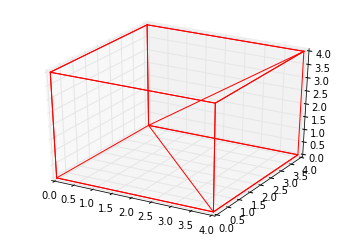

In [115]:
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
from scipy.spatial import ConvexHull  

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

points= np.array([[0,0,0],
            [4,0,0],
            [4,4,0],
            [0,4,0],
            [0,0,4],
            [4,0,4],
            [4,4,4],
            [0,4,4]])

hull=ConvexHull(points)

edges= zip(*points)

for i in hull.simplices:
    plt.plot(points[i,0], points[i,1], points[i,2], 'r-')

ax.plot(edges[0],edges[1],edges[2],'bo') 

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

ax.set_xlim3d(-5,5)
ax.set_ylim3d(-5,5)
ax.set_zlim3d(-5,5)

plt.show()

In [82]:
%matplotlib inline

import matplotlib
import numpy as np
import matplotlib.pyplot as plt


labels = []
x = []
y = []

for word, vector in wordmap.items():
    #print(word, "->" ,vector)
    labels.append(word)
    x.append(vector.get('x'))
    y.append(vector.get('y'))

from scipy.spatial import ConvexHull
import matplotlib.pyplot as plt


plt.figure(figsize=(150, 150))  #in inches


for clusterId, clusterVectors in clusters.items():
    clusterColor =  RGB_tuples[clusterId]
    points = []
    for vec in clusterVectors:
        points.append([vec[0],vec[1]])
     
    points = np.array(points)
    #print(points)
        
    #print("drow cluster #",clusterId, "with color", clusterColor) 
    hull = ConvexHull(points)
    #plt.plot(points[:,0], points[:,1], 'o')
    plt.scatter(points[:,0],points[:,1],c=clusterColor, s=150, edgecolor='none')
    for simplex in hull.simplices:
        plt.plot(points[simplex, 0], points[simplex, 1], 'k-') #
        

        
        
for i, label in enumerate(labels):
    #plt.plot(x[i], y[i], 'ro')
    plt.annotate(label,
                 xy=(x[i], y[i]),
                 xytext=(3, 5),
                 textcoords='offset points',
                 ha='left',
                 va='bottom')
    
#hull_points = cv.vertices
# the vertices of the convex hull

#set(range(len(pointList))).difference(ch.vertices)
# the vertices inside the convex hull


/opt/conda/lib/python3.4/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


In [77]:
w = 'december'

s =  model.findSynonyms(w, 5)

print("word: ", w)
print("(synonim","| similarity rate [0..1])")
print()
for word, cs in s:
    print(word, " : ", cs)


word:  december
(synonim | similarity rate [0..1])

january  :  1.0740713897
sunday  :  1.0733876036
arrives  :  0.967681301576
october  :  0.957454475549
extravaganza  :  0.957385045649
